In [2]:
import numpy as np
import pandas as pd
from scipy.io import loadmat
%matplotlib inline 

import matplotlib.pyplot as plt

path = './data/2015_BOE_Chiu'

In [308]:
data = [
    loadmat(path + '/Subject_0{}.mat'.format(i))
    for i in range(1, 10)
] + [
    loadmat(path + '/Subject_10.mat')
]
 
labeled_examples = [
    np.where(np.isnan(x['manualLayers1']).sum(axis=(0, 1)) != 6144)[0]
    for x in data
]

In [17]:
np.maximum((np.linspace(0.05, 0.95, 9) - 0.05) * 80 / 9, 0).astype(int)


array([0., 1., 2., 3., 4., 5., 6., 7., 8.])

In [309]:
HEIGHT, WIDTH = data[0]['images'][:, :, labeled_examples[0][0]].shape
DIM_START = int((WIDTH - HEIGHT) / 2)
DIM_END = WIDTH - int((WIDTH - HEIGHT) / 2)
LAYERS_TO_USE = list(range(0, 5)) + list(range(5, 8))

In [337]:
NUM_CLASSES = 9
def compute_labels(layer_levels, total_height=HEIGHT, total_width=HEIGHT):
    layer_number = np.zeros((total_height, total_width))

    for maped_class, row in zip(range(1, NUM_CLASSES), layer_levels):
        row = row.astype(int)
        for height, width in zip(row, np.arange(total_width)):
            if np.isnan(height) or height < 0:
                continue
            layer_number[height:total_height, width] = maped_class

    return layer_number

def interpolate_nan_in_manual_layers(manual_layers):
    manual_layers = manual_layers.copy()
    last_not_nan = np.empty(manual_layers.shape)
    last_not_nan[:] = np.nan
    first_not_nan = np.empty(manual_layers.shape)
    first_not_nan[:] = np.nan

    for width, layers_at_width in reversed(list(enumerate(manual_layers.swapaxes(0, 1)))):
        is_nan = np.isnan(layers_at_width)
        if width < 495:
            last_not_nan[is_nan, width] = last_not_nan[is_nan, width + 1]
        last_not_nan[~is_nan, width] = width
        
    for width, layers_at_width in enumerate(manual_layers.swapaxes(0, 1)):
        is_nan = np.isnan(layers_at_width)
        if width > 0:
            first_not_nan[is_nan, width] = first_not_nan[is_nan, width - 1]
        first_not_nan[~is_nan, width] = width
    
    first_not_nan[np.isnan(first_not_nan)] = last_not_nan[np.isnan(first_not_nan)]
    last_not_nan[np.isnan(last_not_nan)] = first_not_nan[np.isnan(last_not_nan)]

    for x, y in zip(*np.where(np.isnan(manual_layers))):
        prev_non_nan = int(first_not_nan[x, y])
        next_non_nan = int(last_not_nan[x, y])
        if prev_non_nan == next_non_nan:
            manual_layers[x, y] = manual_layers[x, next_non_nan]
        else:
            numerator = manual_layers[x, prev_non_nan]*abs(y - next_non_nan) + manual_layers[x, next_non_nan]*abs(y - prev_non_nan)
            manual_layers[x, y] = int(numerator / abs(next_non_nan - prev_non_nan))
    return manual_layers

    

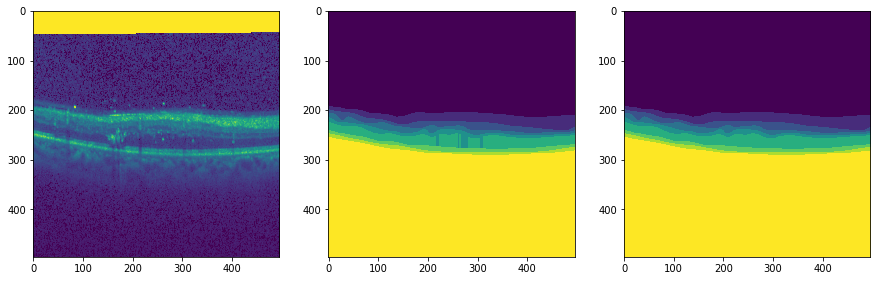

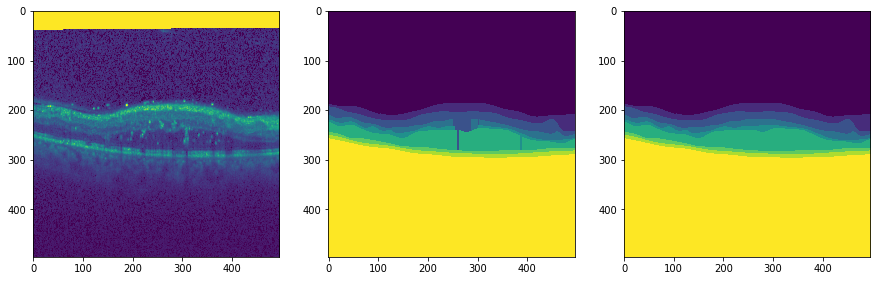

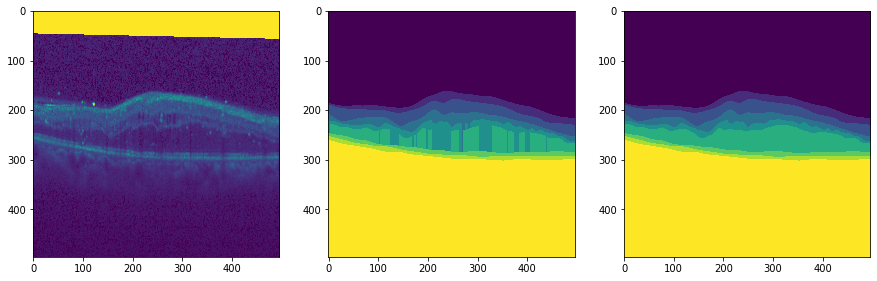

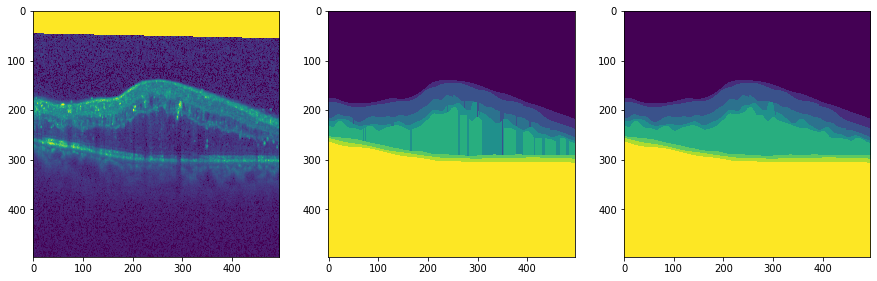

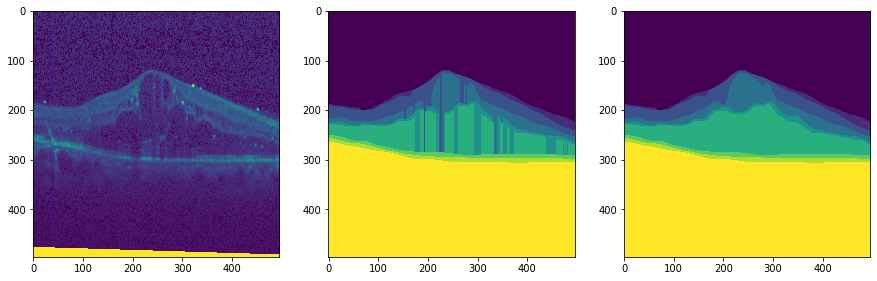

...

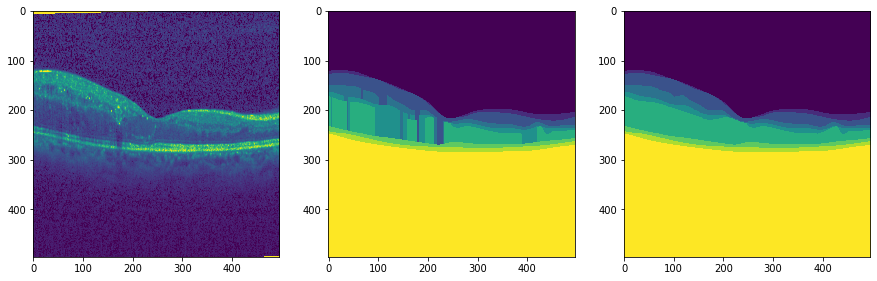

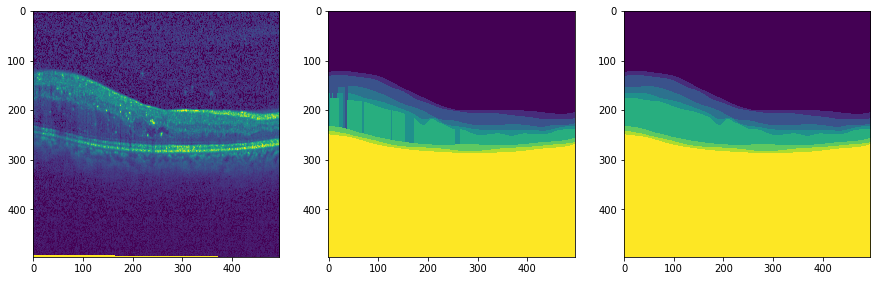

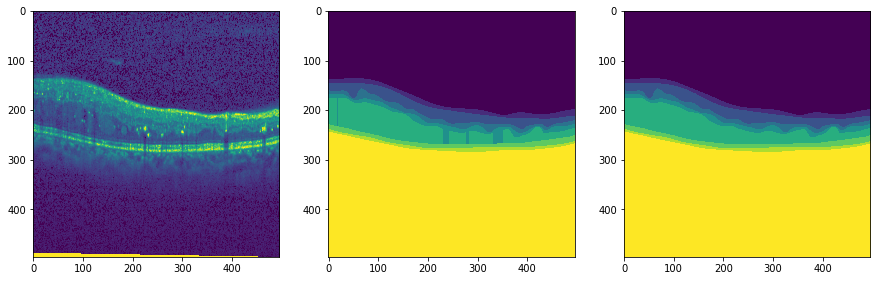

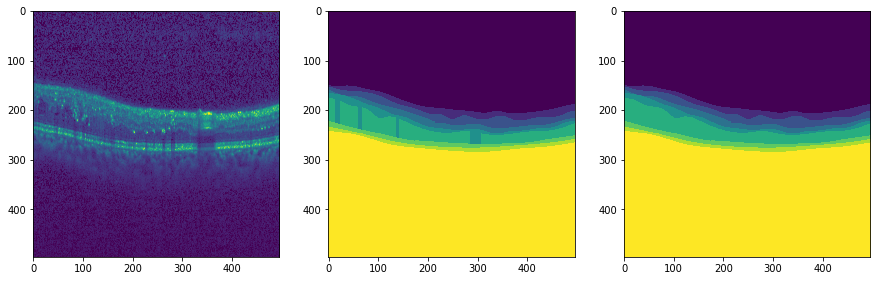

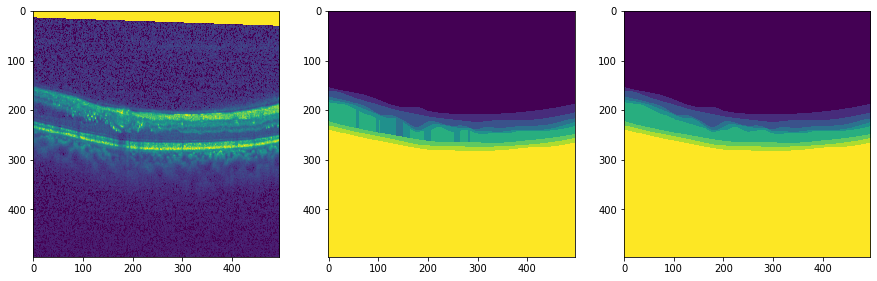

In [339]:
manual_layers = np.array([
    image_data
    for data_fragment, labeled_examples in zip(data, labeled_examples)
    for image_data in data_fragment['manualLayers2'][LAYERS_TO_USE][:, DIM_START:DIM_END][:, :, labeled_examples].swapaxes(2,0).swapaxes(1,2)
])

images = np.array([
    image_data[:, DIM_START:DIM_END]
    for data_fragment, labeled_examples in zip(data, labeled_examples)
    for image_data in data_fragment['images'][:, :, labeled_examples].swapaxes(2,0).swapaxes(1,2)
])

images_labels = np.array([
    compute_labels(image_manual_layers)
    for image_manual_layers in manual_layers
])

for image, label, single_manual_layers in zip(images, images_labels, manual_layers):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(image)
    ax[1].imshow(label)
    ax[2].imshow(compute_labels(interpolate_nan_in_manual_layers(single_manual_layers)))
    plt.show()

In [344]:
np.save('./images', images)

In [348]:
def one_hot_encode(labels):
    encodings = np.eye(9)
    return np.array([
        encodings[label_row.astype(int)]
        for label_row in labels
    ])

def sigmoid_encode(labels):
    encodings = np.linspace(0.05, 0.95, 9)
    return np.array([
        encodings[label_row.astype(int)]
        for label_row in labels
    ])

def couple_hot_encode(labels):
    encoding = np.tril(np.ones((9, 9)), 0)


interpolated_labels = [
    compute_labels(interpolate_nan_in_manual_layers(single_manual_layers))
    for single_manual_layers in manual_layers
]

interpolated_onhot_encoded_labels = [
    sigmoid_encode(interpolated_label)
    for interpolated_label in interpolated_labels
]

interpolated_sigmoid_encoded_labels = [
    sigmoid_encode(interpolated_label)
    for interpolated_label in interpolated_labels
]

interpolated_multiplehot_encoded_labels = [
    couple_hot_encode(interpolated_label)
    for interpolated_label in interpolated_labels
]


np.save('./labels_sigmoid', interpolated_sigmoid_encoded_labels)
np.save('./labels_multiplehot', interpolated_multiplehot_encoded_labels)

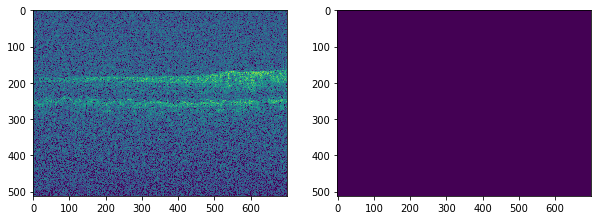

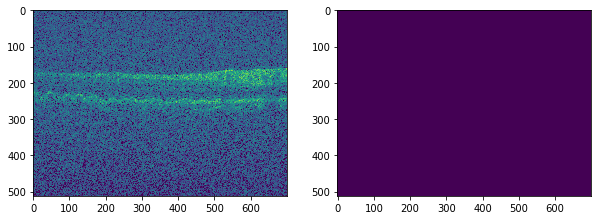

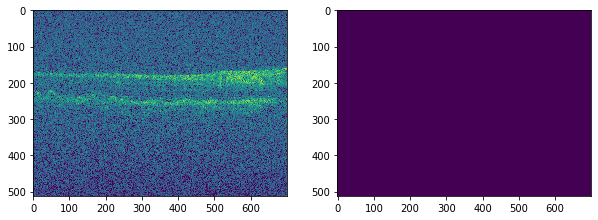

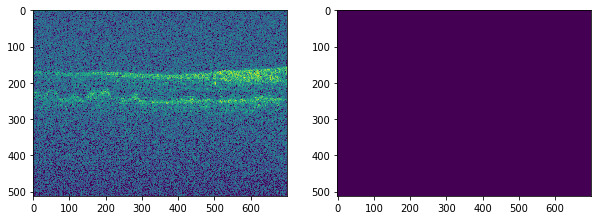

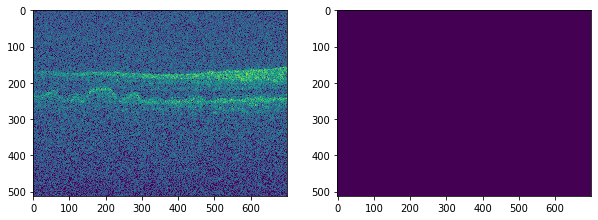

...

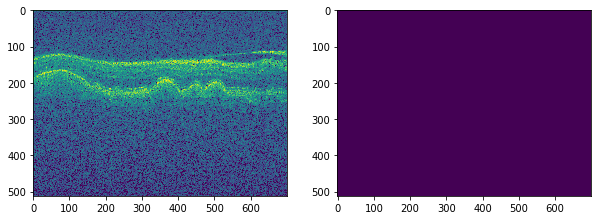

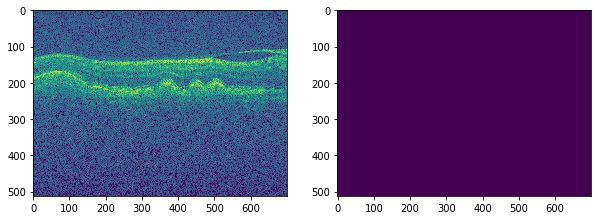

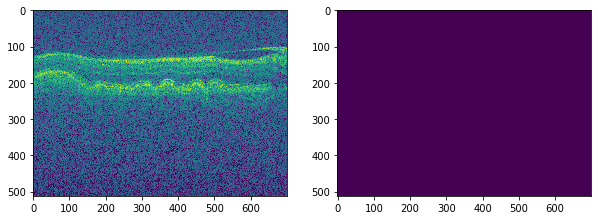

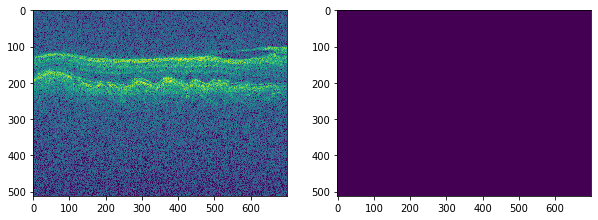

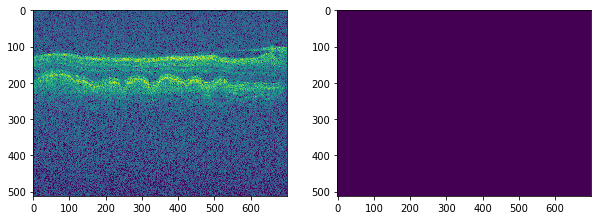

In [212]:
farsiu_data = loadmat('./data/farsiu/Farsiu_Ophthalmology_2013_AMD_Subject_1009.mat')
farsiu_images = farsiu_data['images'].swapaxes(0, 2).swapaxes(1, 2)[:, :, 150:850]
farsiu_labels = [
    compute_labels(
        layers.T,
        total_height=farsiu_images[0].shape[0],
        total_width=farsiu_images[1].shape[1],
    )
    for layers in farsiu_data['layerMaps'][:, 150:850]
]

for image, label in zip(farsiu_images, farsiu_labels):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(image)
    ax[1].imshow(label)
    plt.show()

In [171]:
import os
data_dir = './data/dataverse/'
image_files = []
labels_files = []
for file in os.listdir(data_dir):
    if file.endswith(".jpeg"):
        image_files.append(os.path.join(data_dir, file))
        labels_files.append(os.path.join(data_dir, f"{file}_octSegmentation.mat"))

In [173]:
lb = loadmat(labels_files[0])

In [248]:
import h5py
filename = './data/paper/roamsample_fullsize_test_single.hdf5'

with h5py.File(filename, 'r') as f:
    # List all groups
    print("Keys: %s" % f.keys())
    a_group_key = list(f.keys())[0]

    # Get the data
    images = f['images'][()]
    labels = f['labels'][()]

Keys: <KeysViewHDF5 ['area_names', 'boundary_names', 'fullsize_class_names', 'image_names', 'images', 'labels', 'patch_class_names', 'patch_labels', 'segs']>


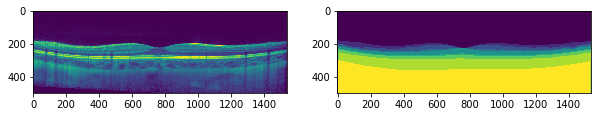

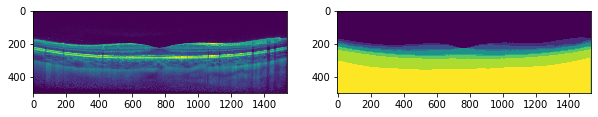

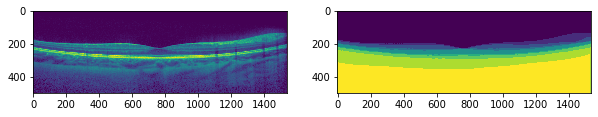

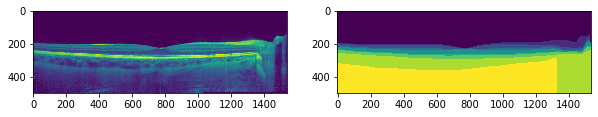

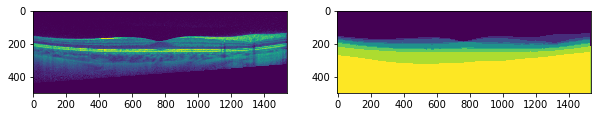

...

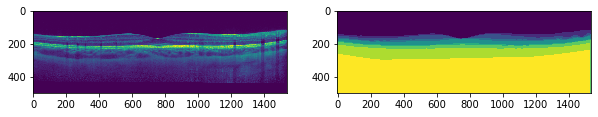

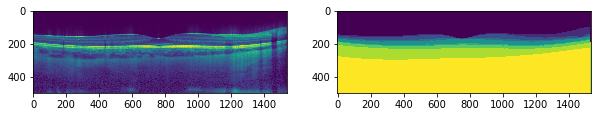

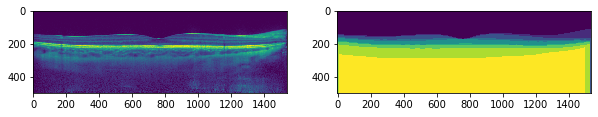

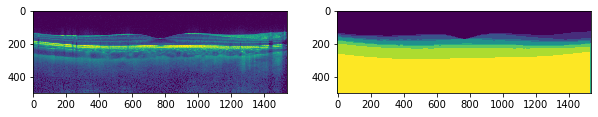

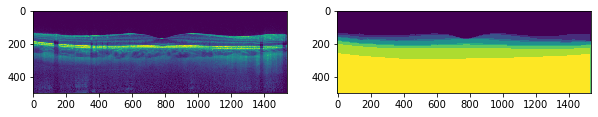

In [249]:
paper_images = images[:, :, :, :, 0].reshape(-1, images.shape[2], images.shape[3]).swapaxes(1, 2)
paper_labels = labels[:, :, :, :, 0].reshape(-1, labels.shape[2], labels.shape[3]).swapaxes(1, 2)

for image, label in zip(paper_images, paper_labels):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(image)
    ax[1].imshow(label)
    plt.show()